This notebook is to perform memory experiments with Stim on quantum LDPC codes by identifying and correcting quantum errors using the the MWPM decoder and analyze the logical vs physical error rate. The quantum error codes tested are the Repetition code, BB code, HGP code, SHP code, SHYPS code, and LP code.  

In [ ]:
!pip install stim pymatching numpy matplotlib qldpc --upgrade

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.5/106.5 kB 4.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 174.3/174.3 kB 9.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 64.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 649.5/649.5 kB 38.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 106.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.5/45.5 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 84.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.2/8.2 MB 102.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pip install --upgrade --force-reinstall numba

  Using cached numpy-2.2.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (62 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 32.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 MB 22.8 MB/s eta 0:00:00
Using cached numpy-2.2.5-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (16.4 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
  Attempting uninstall: llvmlite
    Found existing installation: llvmlite 0.43.0
    Uninstalling llvmlite-0.43.0:
      Successfully uninstalled llvmlite-0.43.0
  Attempting uninstall: numba
    Found existing installation: numba 0.60.0
    Uninstalling numba-0.60.0:
      Successfully uninstalled numba-0.60.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sinter 

In [253]:
import stim
import numpy as np
import matplotlib.pyplot as plt
import qldpc
from qldpc import codes, abstract
import pymatching
from sympy.abc import x, y

In [276]:
class QuantumCode:

  def __init__(self, code_type, distance):
    self.code_type = code_type
    self.distance = distance
    self.n, self.stabilizers = self._get_code_params()

  def _get_code_params(self):

    matrix_a = np.array([
          [1, 1, 0],
          [0, 1, 1]
    ], dtype=np.uint8)
    matrix_b = np.array([
          [1, 1, 0],
          [0, 1, 1]
    ], dtype=np.uint8)

    if self.code_type == "BB":
        orders = {x: 3, y: 2}
        poly_a = x**1 + y**1
        poly_b = x**2 + y**1
        code = codes.BBCode(orders, poly_a, poly_b)

    elif self.code_type == "HGP":
        code = codes.HGPCode(matrix_a, matrix_b)
    elif self.code_type == "SHP":
        code = codes.SHPCode(matrix_a, matrix_b)
    elif self.code_type == "SHYPS":
        code = codes.SHYPSCode(2)
    elif self.code_type == "LP":
            group = abstract.CyclicGroup(2)  # GF(2) cyclic group
            protograph_a = abstract.Protograph.build(
                data=[[1, 0, 1], [0, 1, 1]], group=group
            )
            protograph_b = protograph_a
            code = codes.LPCode(protograph_a, protograph_b)

    print("code: ", code)
    print("code.matrix_x.shape", code.matrix_x.shape)
    print("code.matrix_z.shape", code.matrix_z.shape)
    x_stabilizers = [[(i, 'X') for i in np.flatnonzero(row)]
                  for row in code.matrix_x]
    z_stabilizers = [[(i, 'Z') for i in np.flatnonzero(row)]
                  for row in code.matrix_z]
    return code.num_qubits, x_stabilizers + z_stabilizers

In [200]:
def memory_circuit(code, rounds):
    circuit = stim.Circuit()
    qubits = code.n
    circuit.append("R", range(qubits))
    rec = []
    num_stabilizers = len(code.stabilizers)

    for r in range(rounds):
        ancilla = qubits
        for stabilizer in code.stabilizers:
            circuit.append("R", [ancilla])
            for q, pauli in stabilizer:
                if pauli == 'X':
                    circuit.append("CX", [q, ancilla])
                elif pauli == 'Z':
                    circuit.append("CZ", [q, ancilla])
            circuit.append("M", [ancilla])
            rec.append(ancilla)

            if r > 0:
                circuit.append("DETECTOR", [stim.target_rec(-num_stabilizers-1), stim.target_rec(-1)])
            ancilla += 1

    circuit.append("M", range(qubits))
    for q in range(qubits):
        circuit.append("DETECTOR", [
            stim.target_rec(-len(rec) - qubits + q),
            stim.target_rec(-qubits + q)
        ])
    circuit.append("OBSERVABLE_INCLUDE", [stim.target_rec(-1)], 0 )
    return circuit

In [201]:
def add_depolarizing_noise(circuit, phys_err):
    """Add depolarizing noise after each gate operation"""
    noisy_circuit = stim.Circuit()

    for instruction in circuit:
        noisy_circuit.append(instruction)
        targets = instruction.targets_copy()
        if instruction.name in ["H", "X", "Y", "Z", "S", "SQRT_X", "R"]:
            # Single-qubit gate noise
            noisy_circuit.append("DEPOLARIZE1", targets, phys_err)
        elif instruction.name in ["CX", "CZ", "SWAP"]:
            # Two-qubit gate noise
            noisy_circuit.append("DEPOLARIZE2", targets, phys_err)
        elif instruction.name == "M":
            # Measurement noise
            noisy_circuit.append("X_ERROR", targets, phys_err)
            noisy_circuit.append("Z_ERROR", targets, phys_err)

    return noisy_circuit

In [202]:
def simulate(code_type, distance, rounds, phys_err, decoder):
    code = QuantumCode(code_type, distance)
    circuit = memory_circuit(code, rounds)

    noisy_circuit = add_depolarizing_noise(circuit, phys_err)
    print(noisy_circuit.diagram())

    # Sample errors
    sampler = noisy_circuit.compile_detector_sampler()
    det_events, obs_flips = sampler.sample(shots=1000, separate_observables=True)
    #print("det_events: ", det_events)
    #print("obs_flips: ", obs_flips)

    # Configure decoder
    dem = noisy_circuit.detector_error_model()
    matching = pymatching.Matching.from_detector_error_model(dem)

    # Calculate logical errors
    errors = 0
    for dets, obs in zip(det_events, obs_flips):
        prediction = matching.decode(dets)
        errors += np.any(prediction ^ obs)

    return errors / len(obs_flips)

In [277]:
exp_codes = ["BB", "HGP", "SHP", "SHYPS", "LP"]
decoders = ['MWPM'] #["BP", "BP+OSD"]
error_rates = np.linspace(0.1, 0.4, 5)
distance = 3
rounds = 10
error_rates

array([0.1  , 0.175, 0.25 , 0.325, 0.4  ])

In [278]:
results = {}
for code in exp_codes:
    for decoder in decoders:
        ler = []
        for p in error_rates:
            ler.append(simulate(code, distance, rounds, p, decoder))
        print(ler)
        results[f"{code}_{decoder}"] = ler


code:  BBCode on 12 qubits with cyclic group orders {x: 3, y: 2} and generating polynomials
  A = x + y
  B = x**2 + y
code.matrix_x.shape (6, 12)
code.matrix_z.shape (6, 12)
 q0: -R-DEPOLARIZE1(0.1)---------------------------------------------------------------------------------------------------------------------------------@-------DEPOLARIZE2(0.1)------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------@-------DEPOLARIZE2(0.1)------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

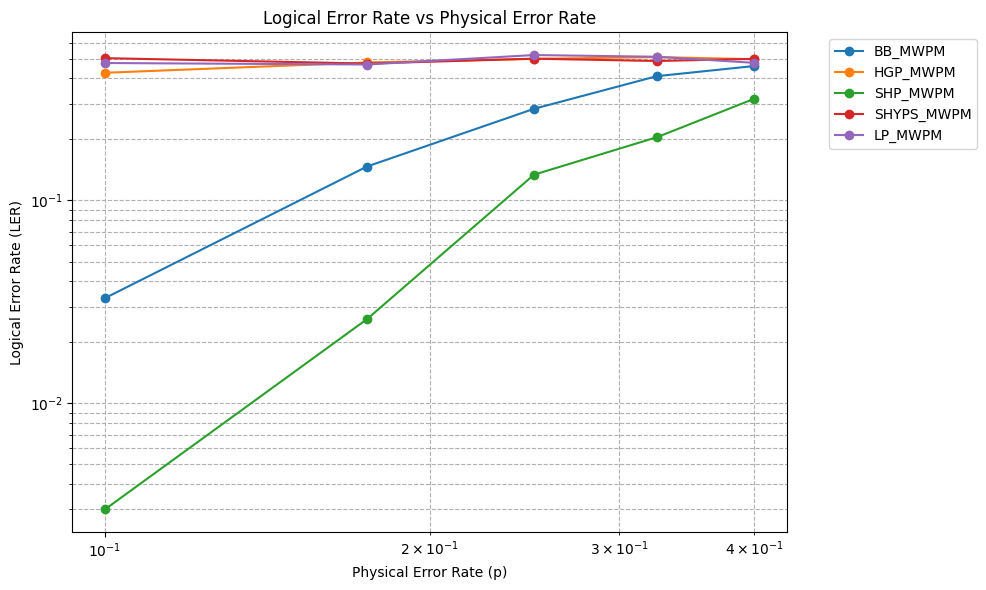

In [279]:
plt.figure(figsize=(10,6))
for key in results:
    plt.loglog(error_rates, results[key], 'o-', label=key)

plt.xlabel("Physical Error Rate (p)")
plt.ylabel("Logical Error Rate (LER)")
plt.title("Logical Error Rate vs Physical Error Rate")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, which='both', linestyle='--')
plt.tight_layout()
plt.show()